In [1]:
import os
try:
    print(file_path)
except:
    file_path = os.path.abspath('')
    os.chdir(os.path.dirname(file_path))
    print(file_path)

d:\Project\face-recogtion-mlops\notebook


# Prepare dataset

In [2]:
import os
import numpy as np
import pandas as pd
from PIL import Image
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
from torchinfo import summary
from torch.utils.data import DataLoader, SubsetRandomSampler
from torchvision import datasets, transforms
from torchvision.transforms import InterpolationMode, v2
from facenet_pytorch import MTCNN, InceptionResnetV1

from src.Utils.utils import *
from src.facenet_triplet.utils import *
from src.facenet_triplet.trainer import fit
from src.facenet_triplet.metrics import AverageNonzeroTripletsMetric

# Set up data loaders
from src.facenet_triplet.datasets import TripletFace, BalancedBatchSampler
from src.facenet_triplet.networks import TripletNet, FacenetEmbeddingNet
from src.facenet_triplet.losses import TripletLoss, OnlineContrastiveLoss

d:\Project\face-recogtion-mlops\.venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:

# Define device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Define image transformations
transform = transforms.Compose([
    transforms.Resize((160, 160)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])


In [4]:
def load_images_from_folder(folder):
    images = []
    filenames = []
    for filename in os.listdir(folder):
        img_path = os.path.join(folder, filename)
        image = Image.open(img_path).convert('RGB')
        image = transform(image)
        images.append(image)
        filenames.append(img_path)
    return images, filenames

# Load images
images, filenames = load_images_from_folder('data/NAB_faces_cropped/faces')
images = torch.stack(images).to(device)


## Onnx Converter

In [5]:
# Load the facenet model

# res_model = InceptionResnetV1(pretrained=PRETRAINED_MODEL, classify=False,
#                                num_classes=None, device=device)
# facenet_embedding_net = FacenetEmbeddingNet(res_model)

# facenet_embedding_net.load_state_dict(torch.load("models/facenet_tune/facenet_2024_07_17_4.pth"))
facenet_embedding_net = torch.load("models/facenet_tune/facenet_2024_07_18_9.pth")
facenet_embedding_net = facenet_embedding_net.to(device)


# Generate embeddings for all images
with torch.no_grad():
    embeddings = facenet_embedding_net.get_embedding(images)


In [6]:
import torch
import torch.onnx
import onnx
from onnx_tf.backend import prepare
import tensorflow as tf
import os

def convert_pytorch_to_onnx(model, input_shape, onnx_path):
    # Set the model to evaluation mode
    model.eval()

    # Create a dummy input tensor
    dummy_input = torch.randn(input_shape, device=device)

    # Export the model to ONNX
    torch.onnx.export(model, 
                      dummy_input, 
                      onnx_path, 
                      export_params=True, 
                      opset_version=15, 
                      do_constant_folding=True,
                      input_names=['input'],
                      output_names=['embeddings'],
                      dynamic_axes={'input': {0: 'batch_size'},
                                    'embeddings': {0: 'batch_size'}})
    
    print(f"PyTorch model exported to ONNX: {onnx_path}")

def convert_onnx_to_tf(onnx_path, tf_path):
    # Load the ONNX model
    onnx_model = onnx.load(onnx_path)
    
    # Convert ONNX model to TensorFlow
    tf_rep = prepare(onnx_model)
    
    # Export the TensorFlow model
    tf_rep.export_graph(tf_path)
    
    print(f"ONNX model converted to TensorFlow: {tf_path}")

def freeze_tf_graph(tf_path, output_node_names, frozen_graph_path):
    # We load the protobuf file from the disk and parse it to retrieve the unserialized graph_def
    with tf.gfile.GFile(tf_path, "rb") as f:
        graph_def = tf.GraphDef()
        graph_def.ParseFromString(f.read())

    # We import the graph_def into a new Graph
    with tf.Graph().as_default() as graph:
        tf.import_graph_def(graph_def, name="")

    # We start a session and retrieve the operations
    with tf.Session(graph=graph) as sess:
        # We freeze the graph and convert variables to constants
        frozen_graph_def = tf.graph_util.convert_variables_to_constants(
            sess,
            graph.as_graph_def(),
            output_node_names
        )

        # We serialize and save the frozen graph to disk
        with tf.gfile.GFile(frozen_graph_path, "wb") as f:
            f.write(frozen_graph_def.SerializeToString())

    print(f"Frozen graph saved: {frozen_graph_path}")

d:\Project\face-recogtion-mlops\.venv\lib\site-packages\tensorflow_addons\utils\tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


In [7]:

# Load your PyTorch model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
facenet_embedding_net = torch.load("models/facenet_tune/facenet_2024_07_18_9.pth", map_location=device)
facenet_embedding_net = facenet_embedding_net.to(device)

# Set the model to evaluation mode
facenet_embedding_net.eval()

# Define the input shape
batch_size = 1
channels = 3
height = 160  # Adjust based on your model's input size
width = 160   # Adjust based on your model's input size
input_shape = (batch_size, channels, height, width)

# Define paths
onnx_path = "models/facenet_embedding_net.onnx"
tf_path = "models/facenet_embedding_net_tf"
frozen_graph_path = "models/facenet_embedding_net_frozen.pb"

# Convert PyTorch to ONNX
convert_pytorch_to_onnx(facenet_embedding_net, input_shape, onnx_path)

# Convert ONNX to TensorFlow
convert_onnx_to_tf(onnx_path, tf_path)

# Freeze the TensorFlow graph
output_node_names = ["embeddings"]  # Adjust this based on your model's output node name
freeze_tf_graph(tf_path, output_node_names, frozen_graph_path)

print("Conversion complete. The frozen TensorFlow graph is saved as:", frozen_graph_path)


PyTorch model exported to ONNX: models/facenet_embedding_net.onnx


ValueError: in user code:

    File "d:\Project\face-recogtion-mlops\.venv\lib\site-packages\onnx_tf\backend_tf_module.py", line 99, in __call__  *
        output_ops = self.backend._onnx_node_to_tensorflow_op(onnx_node,
    File "d:\Project\face-recogtion-mlops\.venv\lib\site-packages\onnx_tf\backend.py", line 347, in _onnx_node_to_tensorflow_op  *
        return handler.handle(node, tensor_dict=tensor_dict, strict=strict)
    File "d:\Project\face-recogtion-mlops\.venv\lib\site-packages\onnx_tf\handlers\handler.py", line 59, in handle  *
        return ver_handle(node, **kwargs)
    File "d:\Project\face-recogtion-mlops\.venv\lib\site-packages\onnx_tf\handlers\backend\batch_normalization.py", line 132, in version_15  *
        return cls._common(node, **kwargs)
    File "d:\Project\face-recogtion-mlops\.venv\lib\site-packages\onnx_tf\handlers\backend\batch_normalization.py", line 41, in _common  *
        x_shape = x.get_shape().as_list()

    ValueError: as_list() is not defined on an unknown TensorShape.


In [ ]:
embeddings.shape

torch.Size([241, 512])

In [ ]:

def cosine_similarity(embedding1, embedding2):
    cos_sim = torch.nn.functional.cosine_similarity(embedding1, embedding2)
    # Scale to [0, 1]
    return (1 + cos_sim) / 2

def calculate_cosine_similarity(embeddings, threshold=0.95):
    similarity_matrix = []
    embeddings = embeddings.cpu()

    for i in range(len(embeddings)):
        row = []
        for j in range(len(embeddings)):
            if i != j:
                sim = cosine_similarity(embeddings[i].unsqueeze(0), embeddings[j].unsqueeze(0))
                row.append(sim.item())
            else:
                row.append(0)
        similarity_matrix.append(row)

    groups = []
    visited = set()
    for i in range(len(similarity_matrix)):
        if i not in visited:
            group = [i]
            visited.add(i)
            for j in range(len(similarity_matrix[i])):
                if similarity_matrix[i][j] > threshold and j not in visited:
                    group.append(j)
                    visited.add(j)
            groups.append(group)
    return groups


# Calculate cosine similarity and group images
groups = calculate_cosine_similarity(embeddings, threshold=0.85)


In [ ]:
# groups

In [ ]:
# Prepare data for CSV
data = []
for group_id, group in enumerate(groups):
    person_count = group_id
    for idx in group:
        data.append([idx, person_count, filenames[idx]])

# Create DataFrame and save to CSV
df = pd.DataFrame(data, columns=["id", "person", "image path"])
df.to_csv("data/grouped_faces.csv", index=False)

print("CSV file created: grouped_faces.csv")


CSV file created: grouped_faces.csv


In [ ]:
import pacmap
import plotly.graph_objects as go
from plotly.subplots import make_subplots

pacmap_instance = pacmap.PaCMAP(n_components=2, n_neighbors=10, MN_ratio=0.5, FP_ratio=2.0)

# Fit and transform the embeddings
embedding_2d = pacmap_instance.fit_transform(embeddings.cpu())

# Create a color map for the groups
unique_groups = np.unique([group_id for group in groups for _ in group])
color_map = plt.colormaps['tab20']

# Create the plot
fig = make_subplots(rows=1, cols=1)

for group_id, group in enumerate(groups):
    if len(group) > 2:  # Only plot groups with more than 2 dots
        group_embeddings = embedding_2d[group]
        color = f'rgb{tuple(int(x*255) for x in color_map(group_id / len(groups))[:3])}'
        
        fig.add_trace(
            go.Scatter(
                x=group_embeddings[:, 0],
                y=group_embeddings[:, 1],
                mode='markers',
                marker=dict(color=color, size=8),
                name=f'Group {group_id}',
                hovertext=[f'Group {group_id}, Index: {idx}' for idx in group],
                showlegend=True
            )
        )

fig.update_layout(
    title='PACMAP 2D Visualization of Face Embeddings',
    xaxis_title='PACMAP Dimension 1',
    yaxis_title='PACMAP Dimension 2',
    legend_title='Groups',
    hovermode='closest',
    width=1000,
    height=800
)

fig.show()

In [ ]:
import pacmap
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import numpy as np

# Initialize PaCMAP with 3 components
pacmap_instance = pacmap.PaCMAP(n_components=3, n_neighbors=10, MN_ratio=0.5, FP_ratio=2.0)

# Fit and transform the embeddings
embedding_3d = pacmap_instance.fit_transform(embeddings.cpu())

# Create a color map for the groups
unique_groups = np.unique([group_id for group in groups for _ in group])
color_map = plt.colormaps['tab20']

# Create the 3D plot
fig = go.Figure()

for group_id, group in enumerate(groups):
    if len(group) > 2:  # Only plot groups with more than 2 dots
        group_embeddings = embedding_3d[group]
        color = f'rgb{tuple(int(x*255) for x in color_map(group_id / len(groups))[:3])}'
        
        fig.add_trace(
            go.Scatter3d(
                x=group_embeddings[:, 0],
                y=group_embeddings[:, 1],
                z=group_embeddings[:, 2],
                mode='markers',
                marker=dict(color=color, size=5),
                name=f'Group {group_id}',
                hovertext=[f'Group {group_id}, Index: {idx}' for idx in group],
                showlegend=True
            )
        )

fig.update_layout(
    title='3D PACMAP Visualization of Face Embeddings',
    scene=dict(
        xaxis_title='PACMAP Dimension 1',
        yaxis_title='PACMAP Dimension 2',
        zaxis_title='PACMAP Dimension 3',
    ),
    legend_title='Groups',
    width=1000,
    height=800
)

fig.show()

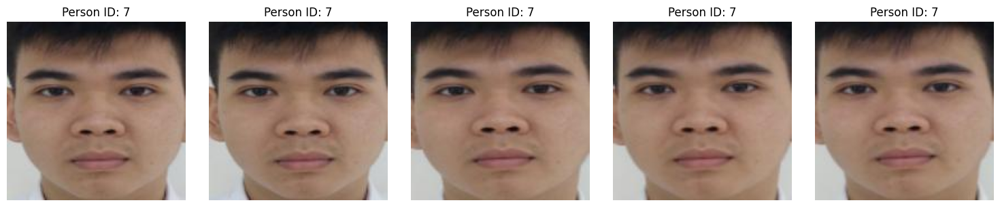

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os

# Load the CSV file containing the grouped faces information
df = pd.read_csv("data/grouped_faces.csv")

# Function to show images of a specific person
def show_images_of_person(person_id):
    # Filter the DataFrame for the specified person
    person_images = df[df['person'] == person_id]
    
    # Get the image paths
    image_paths = person_images['image path'].tolist()
    
    return image_paths

# Function to display the images
# Function to display the images
def display_images(image_paths, person_id):
    # Set up the number of images to display
    n_images = len(image_paths)
    cols = 5  # Number of columns for the display
    rows = (n_images // cols) + (n_images % cols > 0)  # Calculate the number of rows

    # Create a figure to display images
    plt.figure(figsize=(15, 3 * rows))
    
    for i, image_path in enumerate(image_paths):
        # Read the image
        img = mpimg.imread(image_path)
        
        # Add a subplot for each image
        plt.subplot(rows, cols, i + 1)
        plt.imshow(img)
        plt.axis('off')  # Hide the axes
        plt.title(f"Person ID: {person_id}")  # Set the title as the person_id

    plt.tight_layout()
    plt.show()
# Example: Get images for person 1
person_id = 7
image_paths = show_images_of_person(person_id)

# Display images for person 1
display_images(image_paths, person_id)


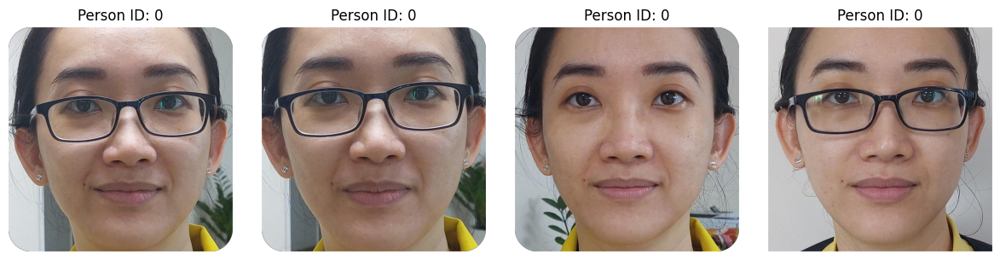

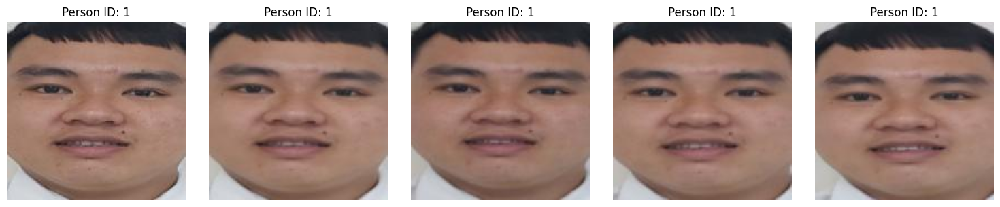

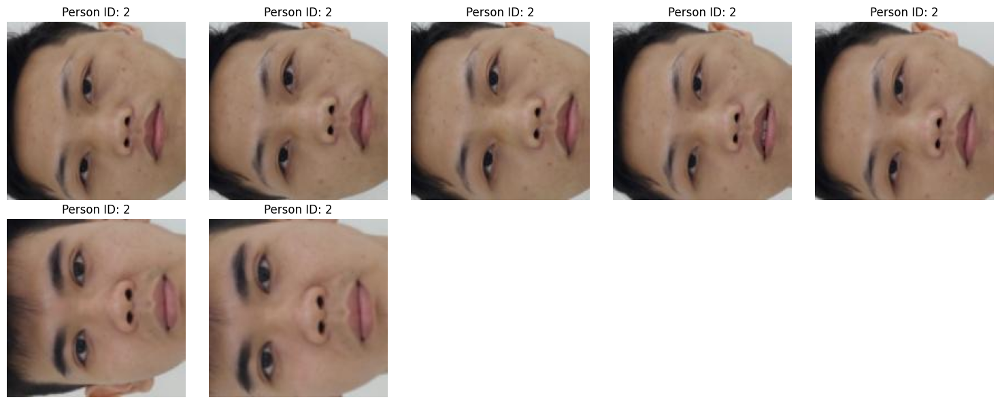

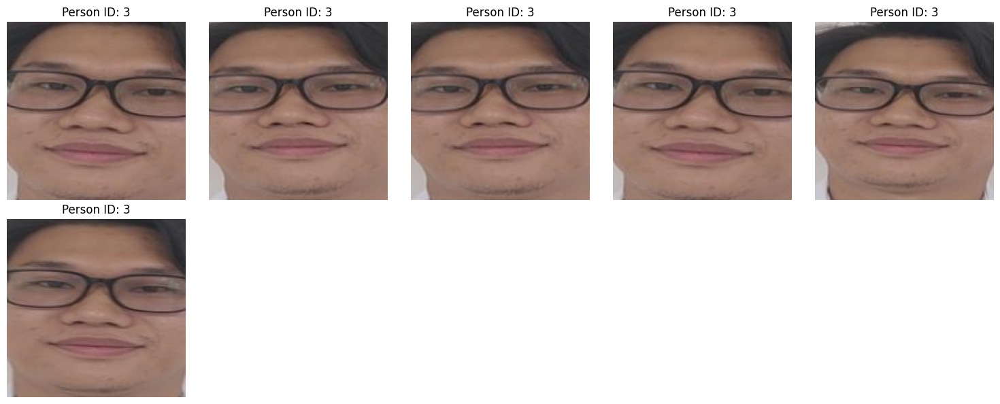

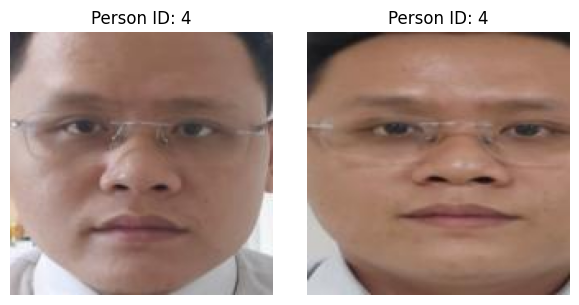

...

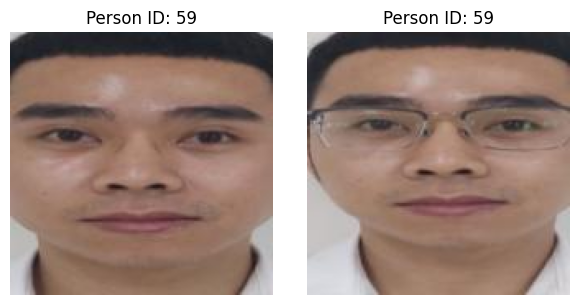

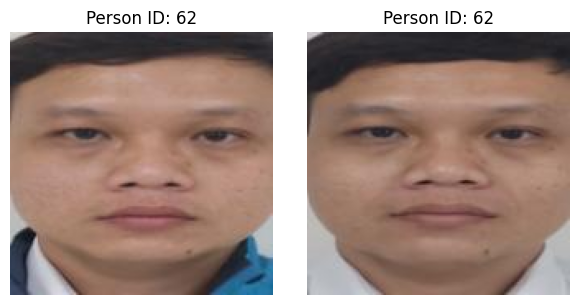

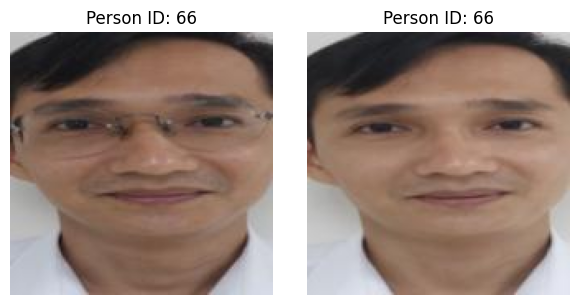

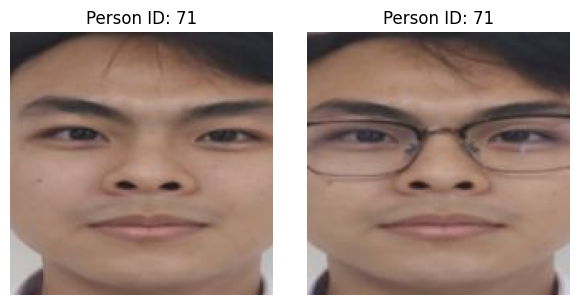

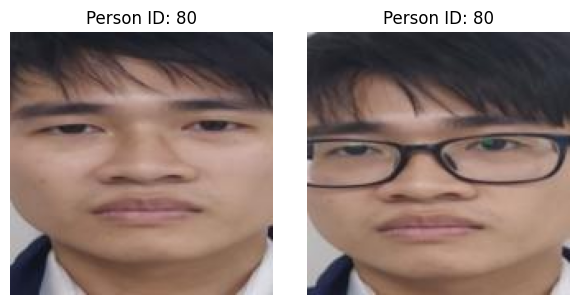

In [ ]:
# Get unique person_ids from the DataFrame
unique_person_ids = df['person'].unique()

# Iterate over each unique person_id and display their images
for person_id in unique_person_ids:
    # Get image paths for the current person_id
    image_paths = show_images_of_person(person_id)
    if len(image_paths) == 1:
        continue
    
    # Display images for the current person_id
    display_images(image_paths, person_id)

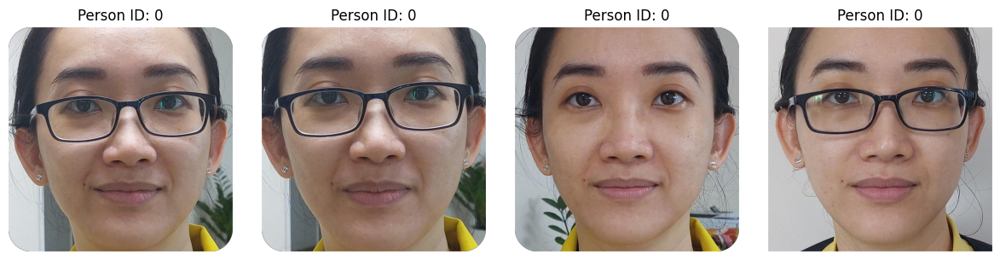

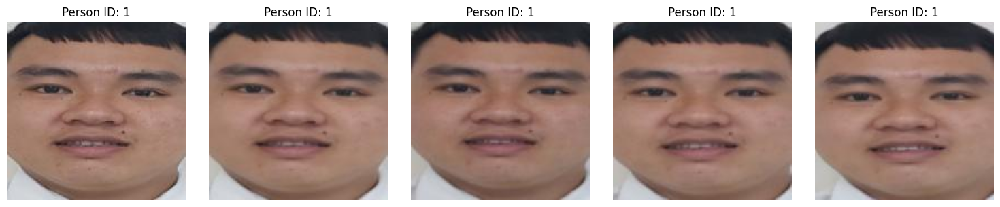

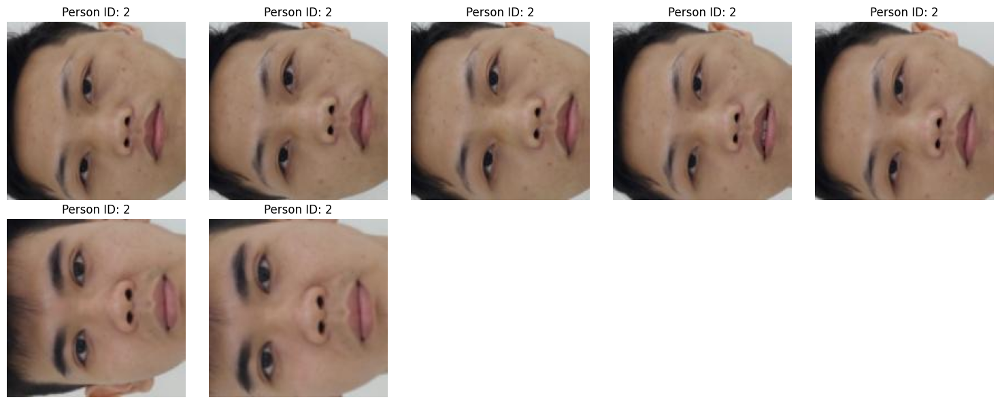

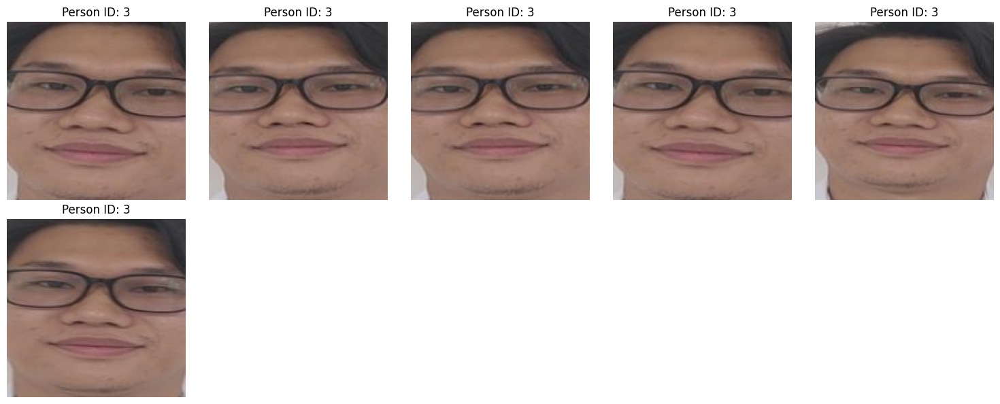

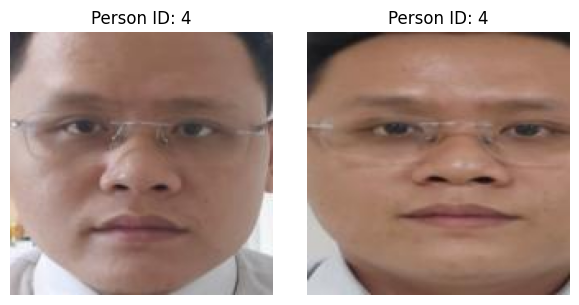

...

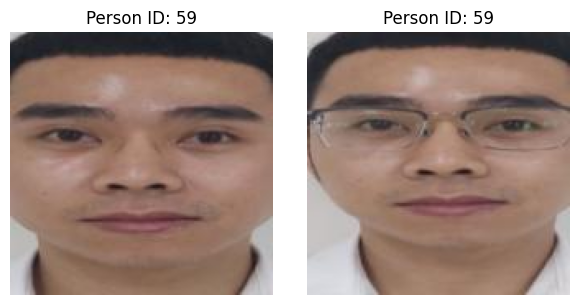

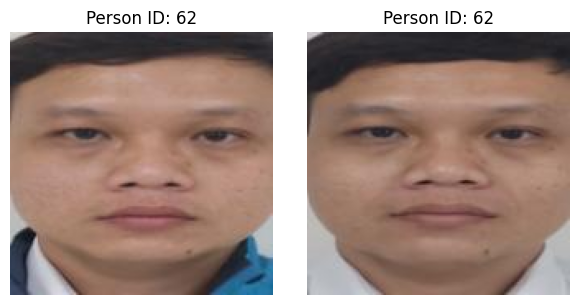

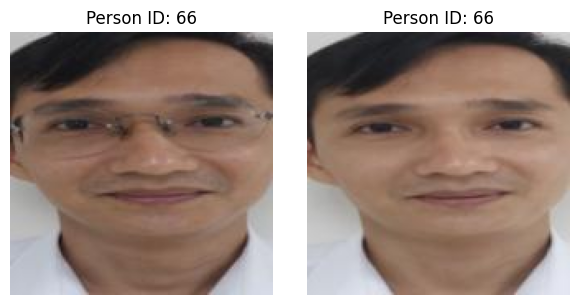

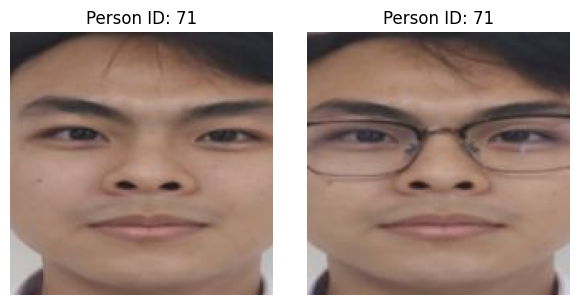

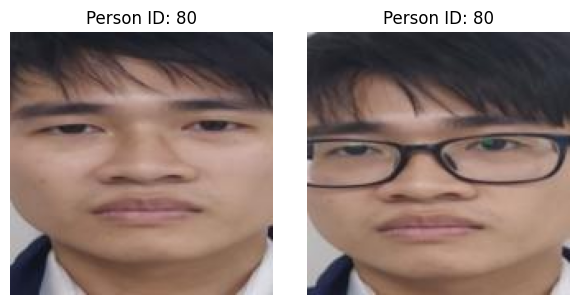

In [ ]:
# Get unique person_ids from the DataFrame
unique_person_ids = df['person'].unique()

# Iterate over each unique person_id and display their images
for person_id in unique_person_ids:
    # Get image paths for the current person_id
    image_paths = show_images_of_person(person_id)
    if len(image_paths) == 1:
        continue
    
    # Display images for the current person_id
    display_images(image_paths, person_id)